In [5]:
import pandas as pd 
import geopandas as gpd
import matplotlib.pyplot as plt

In [6]:
df=pd.read_csv("query.csv")

In [7]:
df.head()

,time,latitude,longitude,depth,mag,magType,nst,gap,dmin,rms,...,updated,place,type,horizontalError,depthError,magError,magNst,status,locationSource,magSource
0,2024-10-08T13:42:21.592Z,53.770300,-166.093800,99.700,2.60,ml,NaN,NaN,NaN,0.70,...,2024-10-08T13:55:52.891Z,"31 km ESE of Unalaska, Alaska",earthquake,NaN,0.400,NaN,NaN,automatic,ak,ak
1,2024-10-08T12:51:37.839Z,-21.200700,-67.754800,162.874,4.60,mb,60.0,45.0,1.5060,0.74,...,2024-10-08T13:11:25.040Z,"51 km E of Ollagüe, Chile",earthquake,3.34,6.830,0.040000,188.0,reviewed,us,us
2,2024-10-08T10:38:44.341Z,-5.738200,107.453100,313.956,4.80,mb,92.0,59.0,1.7240,0.71,...,2024-10-08T11:01:28.040Z,"49 km NNE of Rengasdengklok, Indonesia",earthquake,7.88,5.268,0.059000,89.0,reviewed,us,us
3,2024-10-08T10:25:51.314Z,61.288700,-152.276600,6.600,3.20,ml,NaN,NaN,NaN,0.40,...,2024-10-08T10:28:25.835Z,"66 km WNW of Tyonek, Alaska",earthquake,NaN,0.200,NaN,NaN,automatic,ak,ak
4,2024-10-08T10:09:01.460Z,18.390667,-67.396833,13.810,3.42,md,25.0,148.0,0.1491,0.31,...,2024-10-08T12:17:24.185Z,"16 km WNW of Rincón, Puerto Rico",earthquake,0.57,0.720,0.051033,13.0,reviewed,pr,pr


In [8]:
alert=df[df["mag"]>4]

In [9]:
alert[alert['place'].str.contains('Iran')]

,time,latitude,longitude,depth,mag,magType,nst,gap,dmin,rms,...,updated,place,type,horizontalError,depthError,magError,magNst,status,locationSource,magSource
114,2024-10-05T19:15:34.362Z,35.3597,52.8989,10.0,4.5,mb,52.0,142.0,4.934,0.81,...,2024-10-07T22:46:32.382Z,"50 km WSW of Semnan, Iran",earthquake,11.10,1.931,0.092,35.0,reviewed,us,us
141,2024-10-05T03:29:26.129Z,32.3247,56.4756,10.0,4.1,mb,20.0,128.0,7.356,0.66,...,2024-10-05T03:48:55.040Z,"121 km NNW of Rāvar, Iran",earthquake,7.84,1.959,0.101,27.0,reviewed,us,us


In [10]:
df.groupby('magSource').max('mag')

,latitude,longitude,depth,mag,nst,gap,dmin,rms,horizontalError,depthError,magError,magNst
magSource,,,,,,,,,,,,
ak,69.376800,176.408700,199.9000,4.30,18.0,338.00,1.3040,1.1700,14.030000,15.63900,NaN,NaN
ci,36.145167,-116.572667,19.2500,3.99,183.0,125.00,0.3020,0.2900,0.480000,1.56000,0.200000,356.0
guc,-22.311600,-67.425400,225.5970,4.10,17.0,150.00,2.2100,0.6900,12.370000,14.75200,NaN,NaN
hv,19.649167,-155.236664,38.2100,3.28,62.0,283.00,0.4757,0.3700,1.160000,31.61000,0.260000,43.0
mb,45.216667,-112.469167,4.4300,2.78,33.0,70.00,0.1713,0.1500,0.250000,1.30000,0.222955,45.0
nc,40.410333,-118.845665,25.9300,4.02,126.0,290.00,0.9352,0.2900,2.230000,31.61000,0.377000,100.0
nm,36.241500,-89.497833,9.7300,2.50,45.0,42.00,NaN,0.1100,0.190000,0.35000,0.137096,35.0
nn,40.231900,-114.980300,10.9000,3.30,18.0,131.08,0.7130,0.1534,NaN,3.60000,0.570000,12.0
pr,19.654100,-64.347833,144.0000,3.81,25.0,321.00,1.5092,0.6600,11.610000,31.61000,0.300000,19.0


In [11]:
geo = gpd.points_from_xy(df.longitude , df.latitude , crs=4326)

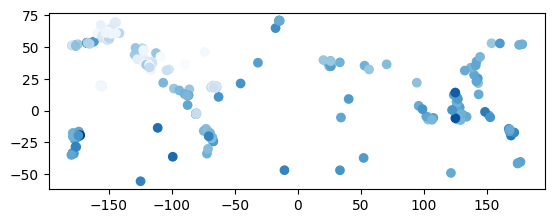

In [12]:
eq= gpd.GeoDataFrame(df, geometry=geo)
eq.plot('mag',cmap="Blues")
plt.savefig("eq.jpg")

In [13]:
parcel75= gpd.read_file(r"draft\draft\R01M4.shp")

In [14]:
parcel85=gpd.read_file(r'draft\draft\R01M5.shp')

In [15]:
parcel75.head()

,ID,tarakom,LU,luShora,geometry
0,39060001.0,120,مسكوني,1,"POLYGON ((536740.59 3963532.08, 536743.33 3963..."
1,39062001.0,120,مسكوني,1,"POLYGON ((534647.27 3962936.41, 534651.55 3962..."
2,39062002.0,120,مختلط,21,"POLYGON ((534574.75 3963006.02, 534579.42 3963..."
3,39062003.0,120,مسكوني,1,"POLYGON ((534592.48 3962989.88, 534591.55 3962..."
4,39062004.0,120,مشجر,15,"POLYGON ((534571.28 3962968.17, 534591.55 3962..."


In [16]:
parcel85.crs

<Projected CRS: EPSG:32639>
Name: WGS 84 / UTM zone 39N
Axis Info [cartesian]:
- E[east]: Easting (metre)
- N[north]: Northing (metre)
Area of Use:
- name: Between 48°E and 54°E, northern hemisphere between equator and 84°N, onshore and offshore. Azerbaijan. Bahrain. Islamic Republic of Iran. Iraq. Kazakhstan. Kuwait. Oman. Qatar. Russian Federation. Saudi Arabia. Somalia. Turkmenistan. United Arab Emirates. Yemen.
- bounds: (48.0, 0.0, 54.0, 84.0)
Coordinate Operation:
- name: UTM zone 39N
- method: Transverse Mercator
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

In [17]:
joined=gpd.sjoin(parcel75,parcel85)

In [18]:
joined.head()

,ID_left,tarakom,LU,luShora_left,geometry,index_right,FLOOR,USAGE_NAME,luShora_right,ID_right
0,39060001.0,120,مسكوني,1,"POLYGON ((536740.59 3963532.08, 536743.33 3963...",1117,4,مسکوني,1,1118
1,39062001.0,120,مسكوني,1,"POLYGON ((534647.27 3962936.41, 534651.55 3962...",1122,0,باير,99,1123
1,39062001.0,120,مسكوني,1,"POLYGON ((534647.27 3962936.41, 534651.55 3962...",1141,2,مسکوني,1,1142
1,39062001.0,120,مسكوني,1,"POLYGON ((534647.27 3962936.41, 534651.55 3962...",1142,1,مسکوني,1,1143
2,39062002.0,120,مختلط,21,"POLYGON ((534574.75 3963006.02, 534579.42 3963...",1139,2,مسکوني,1,1140


In [21]:
joined["UI"]=joined.index
joined.head()

,ID_left,tarakom,LU,luShora_left,geometry,index_right,FLOOR,USAGE_NAME,luShora_right,ID_right,UI
0,39060001.0,120,مسكوني,1,"POLYGON ((536740.59 3963532.08, 536743.33 3963...",1117,4,مسکوني,1,1118,0
1,39062001.0,120,مسكوني,1,"POLYGON ((534647.27 3962936.41, 534651.55 3962...",1122,0,باير,99,1123,1
1,39062001.0,120,مسكوني,1,"POLYGON ((534647.27 3962936.41, 534651.55 3962...",1141,2,مسکوني,1,1142,1
1,39062001.0,120,مسكوني,1,"POLYGON ((534647.27 3962936.41, 534651.55 3962...",1142,1,مسکوني,1,1143,1
2,39062002.0,120,مختلط,21,"POLYGON ((534574.75 3963006.02, 534579.42 3963...",1139,2,مسکوني,1,1140,2


In [22]:
changed=joined[joined['luShora_left']!=joined['luShora_right']]
changed.head()

,ID_left,tarakom,LU,luShora_left,geometry,index_right,FLOOR,USAGE_NAME,luShora_right,ID_right,UI
1,39062001.0,120,مسكوني,1,"POLYGON ((534647.27 3962936.41, 534651.55 3962...",1122,0,باير,99,1123,1
2,39062002.0,120,مختلط,21,"POLYGON ((534574.75 3963006.02, 534579.42 3963...",1139,2,مسکوني,1,1140,2
3,39062003.0,120,مسكوني,1,"POLYGON ((534592.48 3962989.88, 534591.55 3962...",1138,0,باير,99,1139,3
4,39062004.0,120,مشجر,15,"POLYGON ((534571.28 3962968.17, 534591.55 3962...",1132,0,مسکوني,1,1133,4
4,39062004.0,120,مشجر,15,"POLYGON ((534571.28 3962968.17, 534591.55 3962...",1136,1,مسکوني,1,1137,4


In [24]:
changed['luchange']=changed['luShora_left'].astype(str)+'-->'+changed['luShora_right'].astype(str)
changed.head()

c:\Users\Taha\Documents\GitHub\py--GIS\py-GIS\Lib\site-packages\geopandas\geodataframe.py:1819: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)


,ID_left,tarakom,LU,luShora_left,geometry,index_right,FLOOR,USAGE_NAME,luShora_right,ID_right,UI,luchange
1,39062001.0,120,مسكوني,1,"POLYGON ((534647.27 3962936.41, 534651.55 3962...",1122,0,باير,99,1123,1,1-->99
2,39062002.0,120,مختلط,21,"POLYGON ((534574.75 3963006.02, 534579.42 3963...",1139,2,مسکوني,1,1140,2,21-->1
3,39062003.0,120,مسكوني,1,"POLYGON ((534592.48 3962989.88, 534591.55 3962...",1138,0,باير,99,1139,3,1-->99
4,39062004.0,120,مشجر,15,"POLYGON ((534571.28 3962968.17, 534591.55 3962...",1132,0,مسکوني,1,1133,4,15-->1
4,39062004.0,120,مشجر,15,"POLYGON ((534571.28 3962968.17, 534591.55 3962...",1136,1,مسکوني,1,1137,4,15-->1


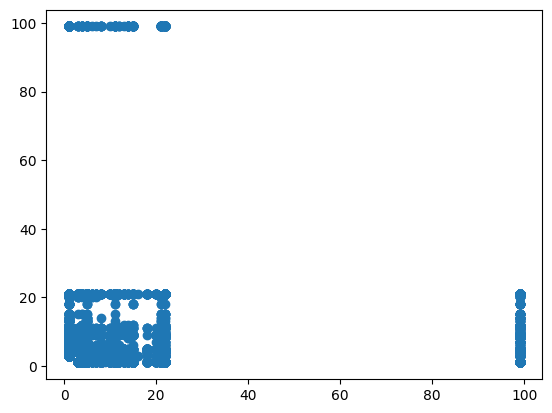

In [26]:
lu75=changed['luShora_left'].values
lu85=changed['luShora_right'].values
plt.plot(lu75,lu85,'o')


In [31]:
changed.explore('luchange',cmap='Accent',legend=True)


In [34]:
changed.groupby('luchange').count()

,ID_left,tarakom,LU,luShora_left,geometry,index_right,FLOOR,USAGE_NAME,luShora_right,ID_right,UI
luchange,,,,,,,,,,,
1-->10,69,69,69,69,69,69,69,69,69,69,69
1-->11,439,439,439,439,439,439,439,439,439,439,439
1-->12,32,32,32,32,32,32,32,32,32,32,32
1-->13,17,17,17,17,17,17,17,17,17,17,17
1-->14,9,9,9,9,9,9,9,9,9,9,9
...,...,...,...,...,...,...,...,...,...,...,...
99-->5,133,133,128,133,133,133,133,133,133,133,133
99-->6,5,5,5,5,5,5,5,5,5,5,5
99-->7,15,15,13,15,15,15,15,15,15,15,15


In [37]:
luchanged=changed.dissolve(by='luchange', aggfunc='count')

In [38]:
luchanged['area']=luchanged.area

In [44]:
luchanged.head()

,geometry,ID_left,tarakom,LU,luShora_left,index_right,FLOOR,USAGE_NAME,luShora_right,ID_right,UI,area
luchange,,,,,,,,,,,,
1-->10,"MULTIPOLYGON (((535456.11 3961292.67, 535455.2...",69,69,69,69,69,69,69,69,69,69,42172.944681
1-->11,"MULTIPOLYGON (((537240.56 3960975.32, 537235.3...",439,439,439,439,439,439,439,439,439,439,606883.413313
1-->12,"MULTIPOLYGON (((538338.41 3960174.02, 538326.6...",32,32,32,32,32,32,32,32,32,32,41367.589542
1-->13,"MULTIPOLYGON (((539450.67 3960830.38, 539446.5...",17,17,17,17,17,17,17,17,17,17,9216.358261
1-->14,"MULTIPOLYGON (((535412.09 3962800.33, 535433.7...",9,9,9,9,9,9,9,9,9,9,9317.961711


In [42]:
changed.pivot_table(index='luShora_left', columns='luShora_right',aggfunc='count')

FLOOR                                                       \
luShora_right      1      3      4      5     6      7     8      9     10   
luShora_left                                                                 
1                 NaN  627.0  850.0  872.0  35.0  102.0  57.0  907.0  69.0   
3               590.0    NaN   26.0   17.0   1.0    7.0   3.0   13.0   1.0   
4               254.0   16.0    NaN   21.0   2.0    6.0   1.0   18.0   NaN   
5               967.0   46.0   84.0    NaN   5.0   23.0   6.0   39.0   5.0   
6                25.0    1.0    NaN    2.0   NaN    NaN   NaN    1.0   NaN   
7                35.0    NaN    5.0    8.0   1.0    NaN   NaN    3.0   1.0   
8               115.0    4.0   11.0    7.0   NaN    1.0   NaN   10.0   NaN   
9                 1.0    NaN    NaN    NaN   1.0    NaN   NaN    NaN   NaN   
10              100.0    2.0    3.0    9.0   NaN    1.0   2.0   14.0   NaN   
11              436.0    9.0   25.0   29.0   1.0    5.0   5.0   38.0   NaN   
12               14.0    NaN    NaN    2.0   1.0    NaN   NaN    4.0   NaN   
13               32.0    2.0    2.0   12.0   NaN    NaN   NaN    1.0   NaN   
14               33.0    1.0    6.0    3.0   NaN    NaN   2.0    5.0   NaN   
15              470.0    7.0    4.0    8.0   1.0    NaN   NaN   71.0   NaN   
16                NaN    1.0    NaN    NaN   NaN    NaN   NaN    NaN   NaN   
18               69.0    1.0    8.0   55.0   NaN    NaN   NaN    1.0   NaN   
20               52.0    2.0    NaN    8.0   NaN    1.0   NaN    9.0   NaN   
21             3967.0   47.0   85.0  393.0   4.0   15.0   6.0   72.0  10.0   
22             5431.0   33.0   87.0   73.0   5.0    5.0   8.0   57.0   5.0   
99             4907.0   46.0   87.0  133.0   5.0   15.0  15.0  282.0   8.0   

                      ... tarakom                                             \
luShora_right     11  ...      10     11    12    13    14    15    18    20   
luShora_left          ...                                                      
1              439.0  ...    69.0  439.0  32.0  17.0   9.0  61.0  21.0  43.0   
3               10.0  ...     1.0   10.0   NaN   NaN   NaN   1.0   NaN   4.0   
4               14.0  ...     NaN   14.0   5.0   NaN   NaN   2.0   NaN   1.0   
5               25.0  ...     5.0   25.0   5.0   7.0   5.0   2.0   3.0   NaN   
6                2.0  ...     NaN    2.0   NaN   NaN   NaN   NaN   NaN   2.0   
7                3.0  ...     1.0    3.0   NaN   NaN   NaN   NaN   NaN   1.0   
8                8.0  ...     NaN    8.0   NaN   NaN   1.0   NaN   NaN   NaN   
9                NaN  ...     NaN    NaN   NaN   NaN   NaN   NaN   NaN   NaN   
10               3.0  ...     NaN    3.0   NaN   NaN   NaN   NaN   NaN   NaN   
11               NaN  ...     NaN    NaN  16.0   1.0   NaN   1.0   2.0   1.0   
12              11.0  ...     NaN   11.0   NaN   NaN   NaN   NaN   NaN   NaN   
13               2.0  ...     NaN    2.0   1.0   NaN   NaN   NaN   NaN   NaN   
14               3.0  ...     NaN    3.0   1.0   NaN   NaN   NaN   NaN   NaN   
15               5.0  ...     NaN    5.0   3.0   NaN   NaN   NaN   4.0   NaN   
16               NaN  ...     NaN    NaN   NaN   NaN   NaN   NaN   NaN   NaN   
18               4.0  ...     NaN    4.0   NaN   NaN   NaN   NaN   NaN   NaN   
20               1.0  ...     NaN    1.0   NaN   NaN   NaN   NaN   NaN   NaN   
21              65.0  ...    10.0   65.0   8.0   3.0   2.0   4.0   2.0   6.0   
22              62.0  ...     5.0   62.0   6.0   1.0   2.0   6.0   1.0   NaN   
99             106.0  ...     8.0  106.0  17.0   5.0  12.0  18.0  11.0   6.0   

                              
luShora_right      21     99  
luShora_left                  
1              7569.0  470.0  
3                95.0    6.0  
4                58.0    9.0  
5               575.0   21.0  
6                 9.0    1.0  
7                10.0    1.0  
8                20.0    6.0  
9                 NaN    NaN  
10               40.0    1.0  
11      

In [46]:
green_changed=changed[changed['luShora_left']==15]

In [57]:
output=green_changed.explore('luShora_right',cmap='Greens',legend=True, categorical=True)

In [58]:
output.save('draft/G1.html')